In [1]:
from pygel3d import hmesh, jupyter_display as jd, gl_display as gl, graph
import numpy as np
import math
from commons.utils import *
from commons.display import *
from commons.medial_axis import *
from random import random
from scipy.spatial import KDTree
from medial_axis_processing.smoothing import *
from medial_axis_loader import from_qmat, from_dpc, from_coverage_axis

%load_ext autoreload
%autoreload 2

In [14]:
# # Add high frequency noise to mesh

# hand = hmesh.load('data/input/hand_sampled.obj')
# noise = np.random.normal(scale=0.0017, size=hand.positions().shape)
# hand.positions()[:] += noise
# hmesh.off_save('data/input/hand_sampled_noisy.off', hand)
# jd.display(hand)

FigureWidget({
    'data': [{'color': '#dddddd',
              'flatshading': False,
              'i': array([  219,   227,   219, ...,     0,     0, 24757]),
              'j': array([24757, 24756,     2, ..., 24745, 24757,    37]),
              'k': array([    0,     1, 24757, ...,    34, 24745, 24745]),
              'type': 'mesh3d',
              'uid': '2c8f431e-8973-443f-b57a-21cdc360b154',
              'x': array([0.38292428, 0.3982748 , 0.39969178, ..., 0.42084425, 0.40698094,
                          0.39412941]),
              'y': array([0.96146206, 0.96603877, 0.97184139, ..., 0.96776212, 0.96941511,
                          0.96958771]),
              'z': array([0.19272951, 0.19913413, 0.18751101, ..., 0.19381998, 0.19212754,
                          0.18949545])},
             {'hoverinfo': 'none',
              'line': {'color': 'rgb(125,0,0)', 'width': 1},
              'mode': 'lines',
              'type': 'scatter3d',
              'uid': '6015a710-2042-4db4-

In [3]:
input_mesh = hmesh.load("data/input/hand_noisy.off")
jd.display(input_mesh)

FigureWidget({
    'data': [{'color': '#dddddd',
              'flatshading': False,
              'i': array([ 116,  119,  116, ..., 6187, 6173, 6190]),
              'j': array([   0,    1,    1, ..., 6190, 6190, 6189]),
              'k': array([ 144,  116,    0, ..., 6188, 6187, 6188]),
              'type': 'mesh3d',
              'uid': '52edaae7-4e48-41e7-80be-82c9a5ac8cd4',
              'x': array([0.39264 , 0.410376, 0.420422, ..., 0.560998, 0.571442, 0.554271]),
              'y': array([0.970701 , 0.976884 , 0.970601 , ..., 0.0307341, 0.0364163, 0.0367524]),
              'z': array([0.178133, 0.178732, 0.178231, ..., 0.1859  , 0.189017, 0.17835 ])},
             {'hoverinfo': 'none',
              'line': {'color': 'rgb(125,0,0)', 'width': 1},
              'mode': 'lines',
              'type': 'scatter3d',
              'uid': '370cc2bb-b7b1-4755-9eec-5797f399c865',
              'x': array([0.391617, 0.39264, None, ..., 0.554271, 0.560998, None], dtype=object),
        

In [9]:
# For DPC input
ma_input = "data/dpc/hand_noisy.dpc"
medial_axis = from_dpc.load(input_mesh, ma_input)

# # For QMAT input
# ma_input = "data/qmat/hand_noisy.ma___v_150___e_326___f_178.ma"
# medial_axis = from_qmat.load(input_mesh, ma_input)

# # For Coverage Axis input
# ma_input = "data/coverage_axis/sim_MA___v_67___e_122___f_56.obj"
# medial_axis = from_coverage_axis.load(input_mesh, ma_input)

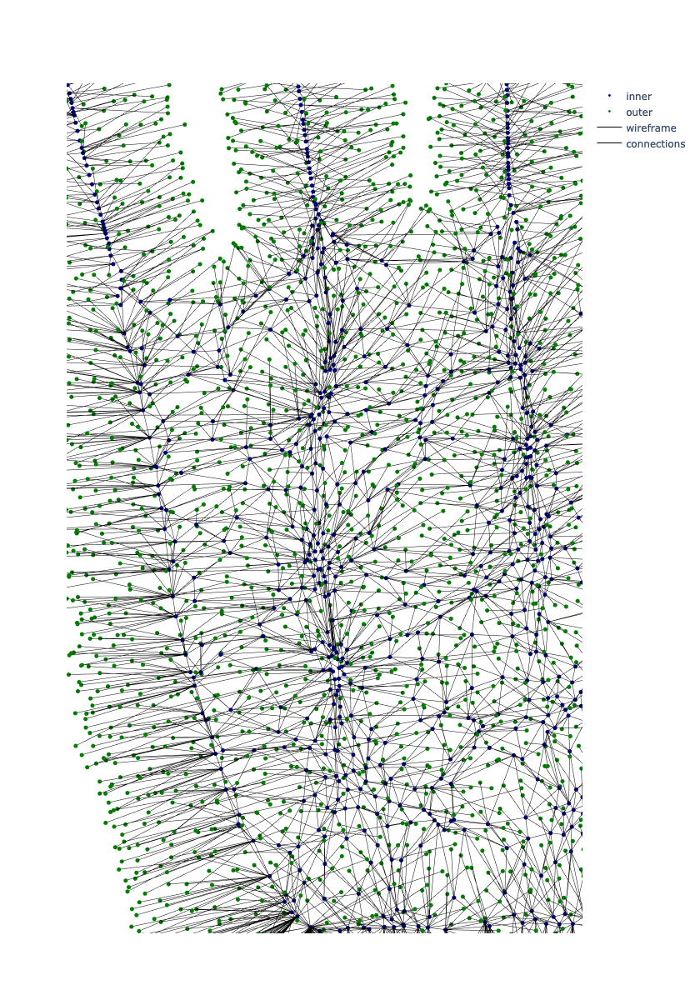

In [11]:
display_medial_axis(medial_axis)

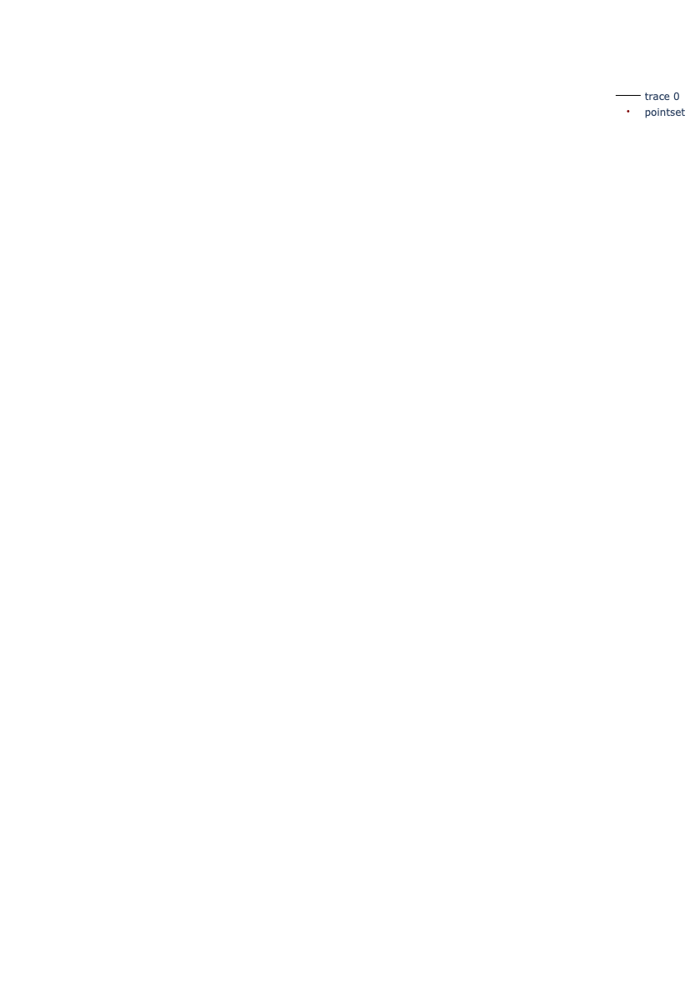

In [10]:
display_graph(medial_axis.graph, show_points=True)

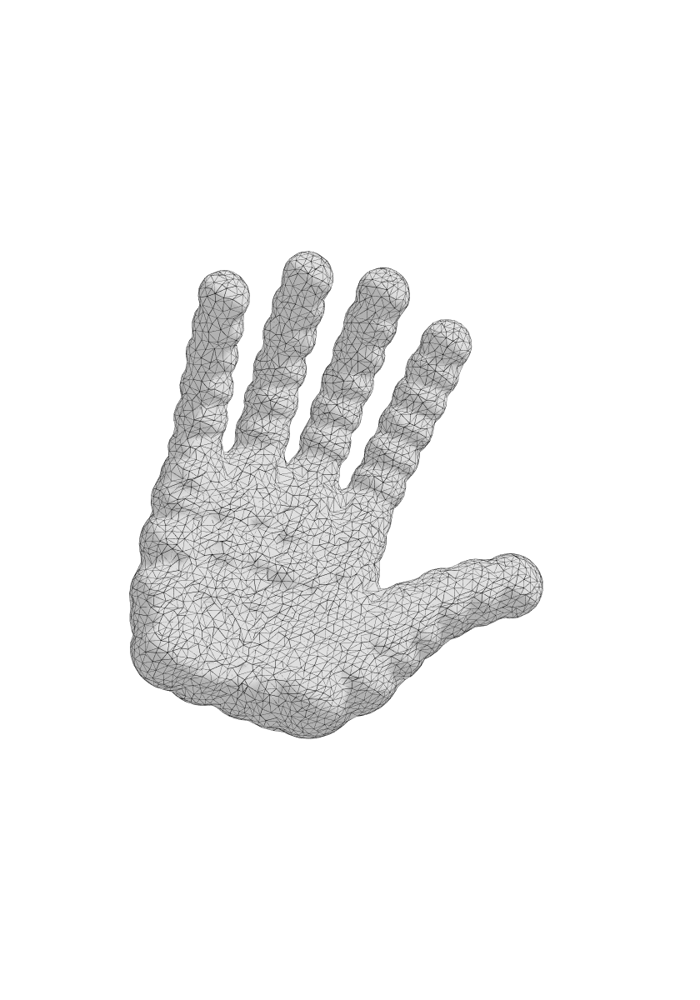

In [6]:
smooth_iter = 1

for _ in range(smooth_iter):
    simple_smooth(medial_axis)
    # medial_axis.update_correspondences(build_ball_correspondences(medial_axis.surface, medial_axis.inner_points, start=0.01, step=0.001))
    
display_mesh(medial_axis.surface)

In [7]:
display_mesh(input_mesh)

In [8]:
orig = hmesh.load("data/input/hand.off")
display_mesh(orig)